# Example spatial transcriptomics (Xenium)

Data downloaded from 10x Genomics (accessed 25/11/2025): https://www.10xgenomics.com/datasets/xenium-prime-ffpe-human-ovarian-cancer

In [1]:
# To run this notebook with CUDA, install dask-cuda:
#    uv pip install dask-cuda==24.12.0
#
# We pin to this version because spatialdata requires
# dask>=2024.10.0,<=2024.11.2, and dask-cuda 24.12.0
# is the latest release compatible with that range.

## 1. Read in the data

In [ ]:
import os

import harpy as hp

path_sdata = os.path.join(
    os.environ.get("TMPDIR"), "sdata.zarr"
)  # or pick a path where the SpatialData object will be backed.

# takes around 7 minutes
sdata = hp.datasets.xenium_human_ovarian_cancer(output=path_sdata)

/data/groups/technologies/spatial.catalyst/Arne/harpy/.venv_harpy_26_11_25/lib/python3.12/site-packages/xarray_schema/__init__.py:1: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import DistributionNotFound, get_distribution
no parent found for <ome_zarr.reader.Label object at 0x7f29fc802ea0>: None


## 2. Plot the images

H&E and annotated H&E

INFO     Rasterizing image for faster rendering.                                                                   
INFO     Rasterizing image for faster rendering.                                                                   


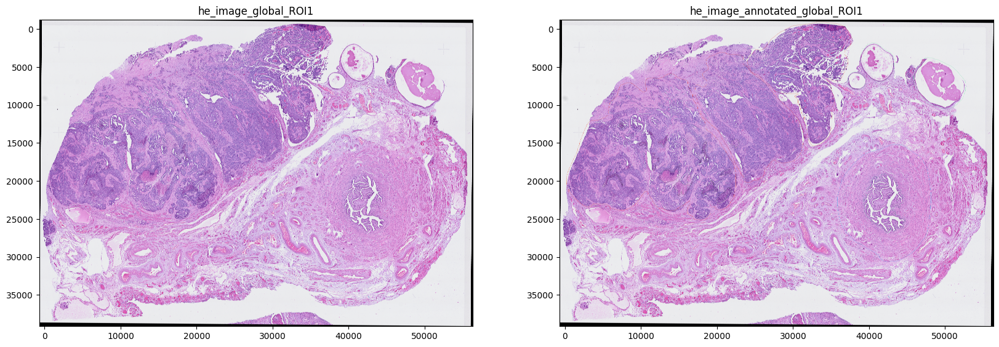

In [3]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(20, 10))

img_layer = ["he_image_global_ROI1", "he_image_annotated_global_ROI1"]

for _img_layer, _ax in zip(img_layer, axes, strict=True):
    show_kwargs = {
        "title": _img_layer,
        "colorbar": False,
    }
    ax = hp.pl.plot_sdata(
        sdata,
        img_layer=_img_layer,
        channel=["r", "g", "b"],
        to_coordinate_system="global_ROI1",  # or if you want to plot in micron coordinates, specify "global_ROI1_micron"
        show_kwargs=show_kwargs,
        ax=_ax,
    )

/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: UserWarning: The object has `points` element. Depending on the number of points, querying MAY suffer from performance issues. Please consider filtering the object before calling this function by calling the `subset()` method of `SpatialData`.
  return dispatch(args[0].__class__)(*args, **kw)
/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: UserWarning: The object has `points` element. Depending on the number of points, querying MAY suffer from performance issues. Please consider filtering the object before calling this function by calling the `subset()` method of `SpatialData`.
  return dispatch(args[0].__class__)(*args, **kw)


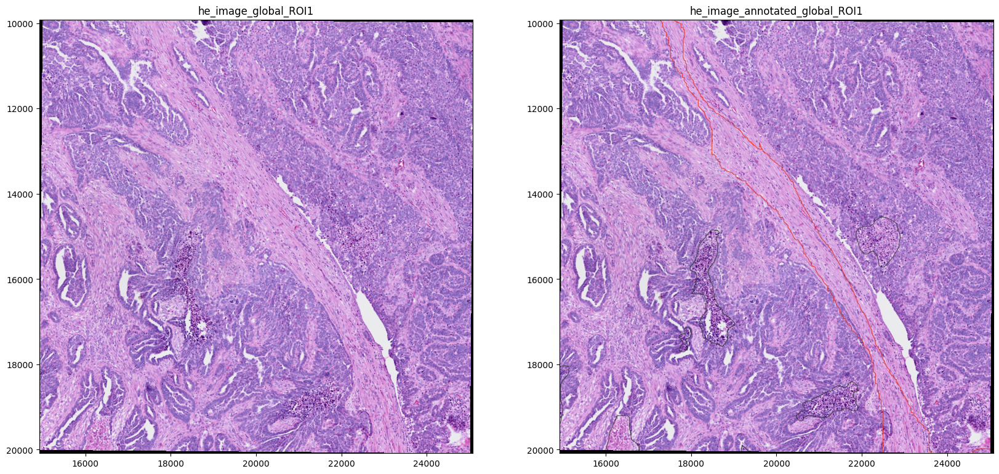

In [4]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(20, 10))

show_kwargs = {"colorbar": False}

img_layer = ["he_image_global_ROI1", "he_image_annotated_global_ROI1"]
for _img_layer, _ax in zip(img_layer, axes, strict=True):
    show_kwargs = {
        "title": _img_layer,
        "colorbar": False,
    }
    ax = hp.pl.plot_sdata(
        sdata,
        img_layer=_img_layer,
        crd=[15000, 25000, 10000, 20000],
        channel=["r", "g", "b"],
        to_coordinate_system="global_ROI1",
        show_kwargs=show_kwargs,
        ax=_ax,
    )

Morphology focus

This is the image that is used for segmentation.

INFO     Rasterizing image for faster rendering.                                                                   
INFO     Your image has 4 channels. Sampling categorical colors and using multichannel strategy 'stack' to render. 


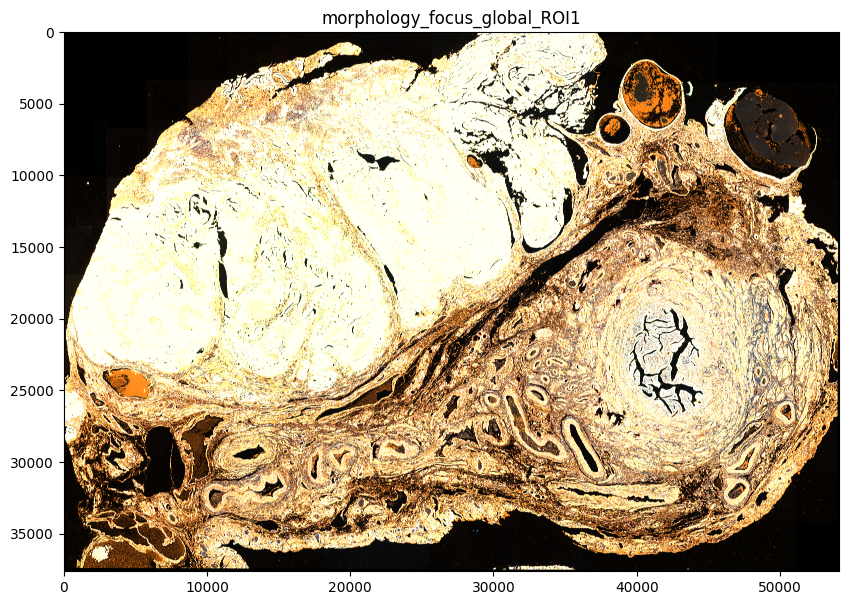

In [13]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize=(10, 10))

img_layer = "morphology_focus_global_ROI1"
channel = hp.im.get_dataarray(sdata, layer=img_layer).c.data.tolist()

show_kwargs = {
    "title": img_layer,
    "colorbar": False,
}
ax = hp.pl.plot_sdata(
    sdata,
    img_layer=img_layer,
    channel=channel,
    to_coordinate_system="global_ROI1",  # or if you want to plot in micron coordinates, specify "global_ROI1_micron"
    show_kwargs=show_kwargs,
    ax=ax,
)

## 2. Visualize the transcripts

2025-11-26 13:23:47,987 - harpy.plot._plot_sdata - INFO - Column 'gene' of 'sdata.points[transcripts_global_ROI1]' is of dtype categorical, while 'genes' is 'None'. We proceed with converting to dtype object, to prevent spatialdata-plot to plot all genes as categories. In case of a backed SpatialData object, this will not affect the underlying zarr store, only the in-memory representation of 'sdata.points[transcripts_global_ROI1][gene]'.


INFO     Value for parameter 'color' appears to be a color, using it as such.                                      
INFO     Rasterizing image for faster rendering.                                                                   


/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                


<Axes: title={'center': 'transcripts'}>

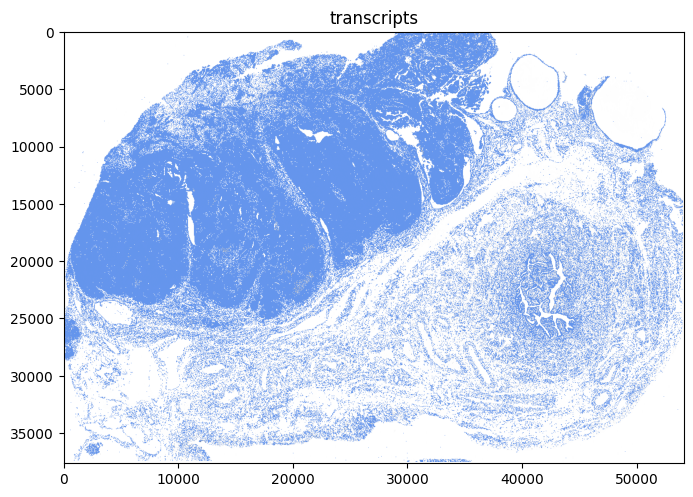

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize=(8, 8))

render_images_kwargs = {
    "cmap": "binary",
}
show_kwargs = {
    "title": "transcripts",
    "colorbar": False,
}

hp.pl.plot_sdata_genes(
    sdata,
    points_layer="transcripts_global_ROI1",
    img_layer="morphology_focus_global_ROI1",
    channel="DAPI",
    genes=None,  # plot all genes
    color="cornflowerblue",
    size=0.1,
    frac=0.01,  # only plot 1% of them
    to_coordinate_system="global_ROI1",
    show_kwargs=show_kwargs,
    render_images_kwargs=render_images_kwargs,
    ax=ax,
)

Now plot some genes associated with tumor cells.

2025-11-26 16:11:45,736 - harpy.plot._plot_sdata - INFO - Plotting column gene of 'sdata.points[transcripts_global_ROI1]' as categorical.


INFO     Rasterizing image for faster rendering.                                                                   


/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


INFO     input has more than 103 categories. Uniform 'grey' color will be used for all categories.                 
INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                


/data/groups/technologies/spatial.catalyst/Arne/harpy/.venv_harpy_26_11_25/lib/python3.12/site-packages/dask/dataframe/core.py:3769: UserWarning: Dask currently has limited support for converting pandas extension dtypes to arrays. Converting string to object dtype.
  warnings.warn(
/data/groups/technologies/spatial.catalyst/Arne/harpy/.venv_harpy_26_11_25/lib/python3.12/site-packages/dask/dataframe/core.py:3769: UserWarning: Dask currently has limited support for converting pandas extension dtypes to arrays. Converting string to object dtype.
  warnings.warn(
2025-11-26 16:12:09,441 - harpy.plot._plot_sdata - INFO - Plotting column gene of 'sdata.points[transcripts_global_ROI1]' as categorical.


INFO     Rasterizing image for faster rendering.                                                                   
INFO     input has more than 103 categories. Uniform 'grey' color will be used for all categories.                 
INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                


/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)
/data/groups/technologies/spatial.catalyst/Arne/harpy/.venv_harpy_26_11_25/lib/python3.12/site-packages/dask/dataframe/core.py:3769: UserWarning: Dask currently has limited support for converting pandas extension dtypes to arrays. Converting string to object dtype.
  warnings.warn(
/data/groups/technologies/spatial.catalyst/Arne/harpy/.venv_harpy_26_11_25/lib/python3.12/site-packages/dask/dataframe/core.py:3769: UserWarning: Dask currently has limited support for converting pandas extension dtypes to arrays. Converting string to object dtype.
  warnings.warn(


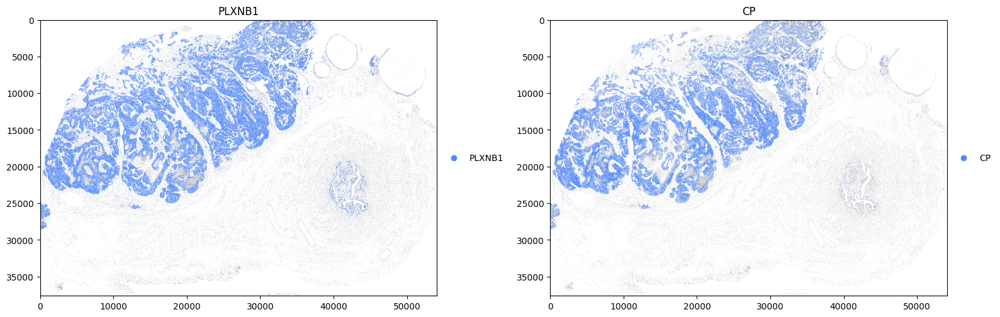

In [ ]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

render_images_kwargs = {
    "cmap": "binary",
}

for gene, ax in zip(["PLXNB1", "CP"], axes, strict=True):
    show_kwargs = {
        "title": gene,
        "colorbar": False,
    }

    hp.pl.plot_sdata_genes(
        sdata,
        points_layer="transcripts_global_ROI1",
        img_layer="morphology_focus_global_ROI1",
        channel="DAPI",
        genes=[
            gene
        ],  #  You could specify a list of genes here. But note that if they occur at same location, they will plotted onto each other.
        palette=["#4D88FF"],
        size=0.1,
        frac=None,
        to_coordinate_system="global_ROI1",
        show_kwargs=show_kwargs,
        render_images_kwargs=render_images_kwargs,
        ax=ax,
    )
plt.tight_layout()
plt.show()

Calculate the transcript density

In [15]:
sdata = hp.im.transcript_density(
    sdata,
    points_layer="transcripts_global_ROI1",
    img_layer="morphology_focus_global_ROI1",
    output_layer="transcript_density",
    to_coordinate_system="global_ROI1",
    scale_factors=[2, 2, 2, 2],
    overwrite=True,
)

2025-11-26 16:16:47,030 - harpy.image._image - INFO - There seems to be more than one coordinate system defined on the provided spatial element ('['global_ROI1', 'global_ROI1_micron']'). We only consider the coordinate sytem specified via parameter 'to_coordinate_system': 'global_ROI1'.
2025-11-26 16:16:49,203 - harpy.image._transcripts - INFO - The number of transcripts ( 147673771 ) is larger than n_sample, sampling 15000000 transcripts.
2025-11-26 16:16:49,214 - harpy.image._transcripts - INFO - sampling finished
2025-11-26 16:16:49,450 - harpy.image._manager - INFO - Writing results to layer 'transcript_density'


INFO     Rasterizing image for faster rendering.                                                                   


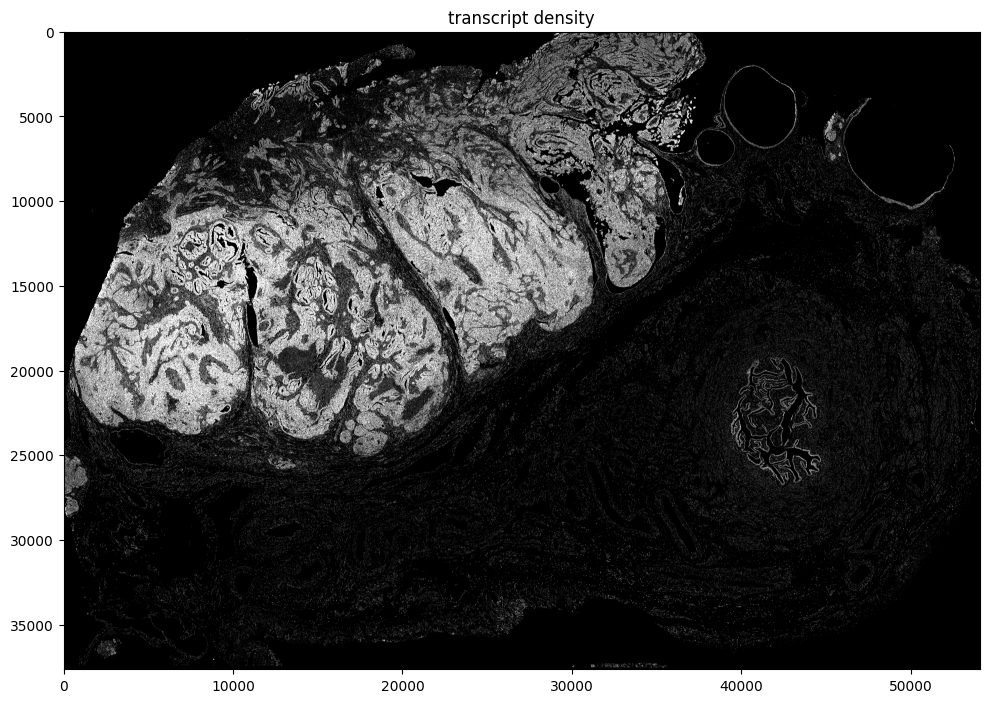

In [17]:
import numpy as np

import dask.array as da

from matplotlib.colors import Normalize

scale = None  # auto pick scale by spatialdata-plot
img_layer = "transcript_density"

fig, ax = plt.subplots(1, 1, figsize=(10, 10))

channel = 0
se = hp.im.get_dataarray(sdata, layer=img_layer)
_channel_idx = np.where(se.c.data == channel)[0].item()
vmax = da.percentile(se.data[_channel_idx].flatten(), q=95).compute()
norm = Normalize(vmax=vmax, clip=False)
print(norm)

crd = None
sdata_to_plot = sdata.subset(element_names=[img_layer])

render_images_kwargs = {"cmap": "grey", "scale": scale, "norm": norm}
show_kwargs = {
    "title": "transcript density",
    "colorbar": False,
}
ax = hp.pl.plot_sdata(
    sdata_to_plot,
    img_layer=img_layer,
    channel=channel,
    crd=crd,
    to_coordinate_system="global_ROI1",
    render_images_kwargs=render_images_kwargs,
    show_kwargs=show_kwargs,
    ax=ax,
)

plt.tight_layout()
plt.show()

## 3. Segmentation

Segmentation is already provided by 10x Genomics. We will inspect these segmentation masks, and also illustate how the user could generate segmentation masks using `harpy`.

First visualize segmentation masks provided by 10x Genomics.

/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: UserWarning: The object has `points` element. Depending on the number of points, querying MAY suffer from performance issues. Please consider filtering the object before calling this function by calling the `subset()` method of `SpatialData`.
  return dispatch(args[0].__class__)(*args, **kw)
/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/functools.py:912: UserWarning: The object has `points` element. Depending on the number of points, querying MAY suffer from performance issues. Please consider filtering the object before calling this function by calling the `subset()` method of `SpatialData`.
  return dispatch(args[0].__class__)(*args, **kw)


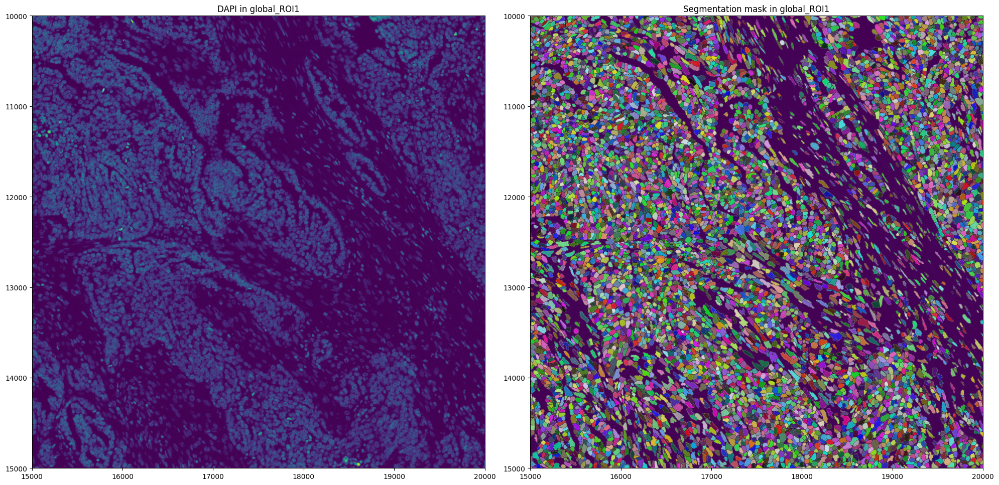

In [20]:
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

channel = "DAPI"
img_layer = "morphology_focus_global_ROI1"
labels_layer = "cell_labels_global_ROI1"

crd = [15000, 20000, 10000, 15000]

to_coordinate_system = "global_ROI1"

render_images_kwargs = {"cmap": "viridis"}
render_labels_kwargs = {"fill_alpha": 0.6, "outline_alpha": 0.4}
show_kwargs = {"title": f"DAPI in {to_coordinate_system}", "colorbar": False}

hp.pl.plot_sdata(
    sdata,
    img_layer=img_layer,
    crd=crd,
    to_coordinate_system=to_coordinate_system,
    channel=channel,
    render_images_kwargs=render_images_kwargs,
    show_kwargs=show_kwargs,
    ax=axes[0],
)
# _ax.axis("off")

show_kwargs = {"title": f"Segmentation mask in {to_coordinate_system}", "colorbar": False}
hp.pl.plot_sdata(
    sdata,
    img_layer=img_layer,
    labels_layer=labels_layer,
    crd=crd,
    to_coordinate_system=to_coordinate_system,
    channel=channel,
    render_images_kwargs=render_images_kwargs,
    render_labels_kwargs=render_labels_kwargs,
    show_kwargs=show_kwargs,
    ax=axes[1],
)
# _ax.axis("off")

plt.tight_layout()
plt.show()

In many cases, you want to generate these segmentation masks yourself. Therefore, for illustration purposes, we show how to segment using [`Cellpose`](https://github.com/MouseLand/cellpose) via `harpy.im.segment`, and how to generate an [`AnnData`](https://anndata.readthedocs.io/en/stable/) table using `hp.tb.allocate`.

Make sure to install [`Cellpose`](https://github.com/MouseLand/cellpose) before running the following cell (`pip install cellpose`).

In [8]:
import os
import torch
from dask.distributed import Client, LocalCluster

if torch.cuda.is_available():
    from dask_cuda import LocalCUDACluster  # pip install dask-cuda

    # One worker per GPU; each worker will be pinned to a single GPU.
    cluster = LocalCUDACluster(
        CUDA_VISIBLE_DEVICES=[0],  # or [0,1],...etc
        n_workers=1,  # 2 if [0,1],...etc
        threads_per_worker=1,
        memory_limit="32GB",
        local_directory=os.environ.get("TMPDIR"),
    )
else:
    # cpu/mps fall back
    from dask.distributed import LocalCluster

    cluster = LocalCluster(
        n_workers=1
        if torch.backends.mps.is_available()
        else 8,  # If mps/cuda device available, it is better to increase chunk size to maximal value that fits on the gpu, and set n_workers to 1.
        # For this dummy example, we only have one chunk, so setting n_workers>1, has no effect.
        threads_per_worker=1,
        memory_limit="32GB",
        local_directory=os.environ.get("TMPDIR"),
    )

client = Client(cluster)

print(client.dashboard_link)

sdata = hp.im.segment(
    sdata,
    img_layer="morphology_focus_global_ROI1",  # note, currently cellpose only supports segmentation of 3 channels. So the channel at index -1 will not be used (AlphaSMA/Vimentin)
    depth=200,
    model=hp.im.cellpose_callable,
    # parameters that will be passed to the callable cellpose_callable
    diameter=50,
    flow_threshold=0.9,
    cellprob_threshold=-4,
    output_labels_layer="cell_labels_harpy_global_ROI1",
    output_shapes_layer=None,
    crd=[15000, 20000, 10000, 15000],
    # region to segment [x_min, xmax, y_min, y_max], must be defined in pixel coordinates, e.g. specify the pixel coordinate system
    to_coordinate_system="global_ROI1",
    overwrite=True,
)
client.close()

/home/VIB.LOCAL/arne.defauw/.local/share/uv/python/cpython-3.12.10-linux-x86_64-gnu/lib/python3.12/importlib/__init__.py:90: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  return _bootstrap._gcd_import(name[level:], package, level)


http://127.0.0.1:8787/status


2025-11-26 16:50:18,342 - harpy.image.segmentation._segmentation - INFO - Provided array is chunked in 'z' and/or 'c' dimension. Will rechunk in 'z' and/or 'c' dimension.
/data/groups/technologies/spatial.catalyst/Arne/harpy/.venv_harpy_26_11_25/lib/python3.12/site-packages/xarray_schema/__init__.py:1: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import DistributionNotFound, get_distribution
pretrained model /home/VIB.LOCAL/arne.defauw/.cellpose/models/cpsam not found, using default model
channels deprecated in v4.0.1+. If data contain more than 3 channels, only the first 3 channels will be used
more than 3 channels provided, only segmenting on first 3 channels
Resizing is deprecated in v4.0.1+
pretrained model /home/VIB.LOCAL/arne.defauw/.cellpose/models/cpsam not found,

Lets inspect the segmentation masks we generated.

INFO     Rasterizing image for faster rendering.                                                                   


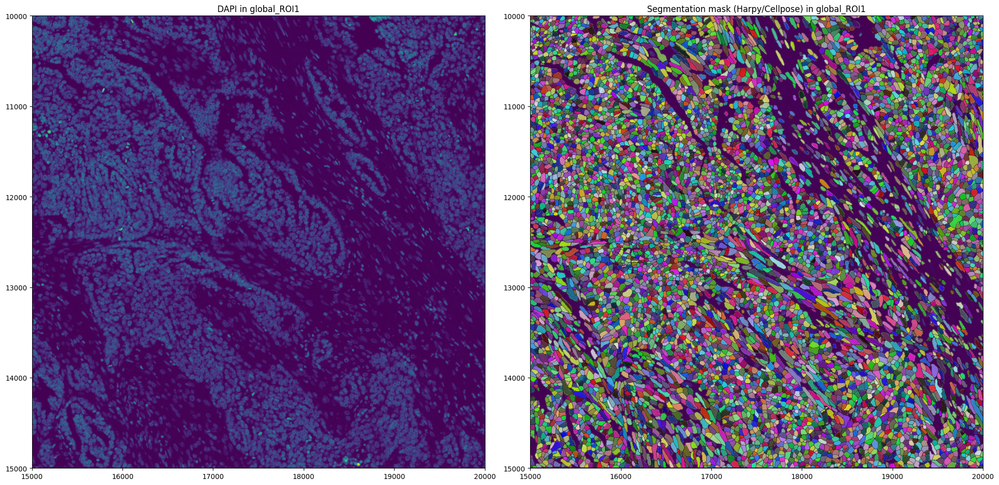

In [11]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(20, 10))

channel = "DAPI"
img_layer = "morphology_focus_global_ROI1"
labels_layer = "cell_labels_harpy_global_ROI1"

crd = [15000, 20000, 10000, 15000]

to_coordinate_system = "global_ROI1"

render_images_kwargs = {"cmap": "viridis"}
render_labels_kwargs = {"fill_alpha": 0.6, "outline_alpha": 0.4}
show_kwargs = {"title": f"DAPI in {to_coordinate_system}", "colorbar": False}

hp.pl.plot_sdata(
    sdata,
    img_layer=img_layer,
    crd=crd,
    to_coordinate_system=to_coordinate_system,
    channel=channel,
    render_images_kwargs=render_images_kwargs,
    show_kwargs=show_kwargs,
    ax=axes[0],
)
# _ax.axis("off")

show_kwargs = {"title": f"Segmentation mask (Harpy/Cellpose) in {to_coordinate_system}", "colorbar": False}
hp.pl.plot_sdata(
    sdata,
    img_layer=img_layer,
    labels_layer=labels_layer,
    crd=crd,
    to_coordinate_system=to_coordinate_system,
    channel=channel,
    render_images_kwargs=render_images_kwargs,
    render_labels_kwargs=render_labels_kwargs,
    show_kwargs=show_kwargs,
    ax=axes[1],
)
# _ax.axis("off")

plt.tight_layout()
plt.show()

## 4. Create the AnnData table

Below we illustrate how an AnnData table can be created using this custom generated segmentation mask via the `harpy` function `harpy.tb.allocate`.

In [ ]:
from dask.distributed import Client, LocalCluster

cluster = LocalCluster(
    n_workers=16,
    threads_per_worker=1,
    processes=True,
    memory_limit="8GB",
    local_directory=os.environ.get("TMPDIR"),  # folder where dask will spill to disk
)

client = Client(cluster)

sdata = sdata = hp.tb.allocate(
    sdata,
    labels_layer="cell_labels_harpy_global_ROI1",
    points_layer="transcripts_global_ROI1",
    output_layer="table_harpy_global_ROI1",
    to_coordinate_system="global_ROI1",  # Do allocation step in the intrinsic pixel coordinate system,
    append=False,
    overwrite=True,
    update_shapes_layers=False,
)

client.close()

## 5. Preprocess the AnnData table

We proceed working with the AnnData table provided by 10x Genomics. But the same logic applies to a custom generated AnnData table.

2025-11-26 19:59:52,772 - harpy.plot._transcripts - WARNING - The count matrix of the provided table layer 'table_global_ROI1', seems to be of type 'float32', which could indicate that the analysis is being run on normalized counts, please consider running this analysis before the counts in the AnnData object are normalized (i.e. on the raw counts).
2025-11-26 19:59:52,777 - harpy.image._image - INFO - There seems to be more than one coordinate system defined on the provided spatial element ('['global_ROI1', 'global_ROI1_micron']'). We only consider the coordinate sytem specified via parameter 'to_coordinate_system': 'global_ROI1'.


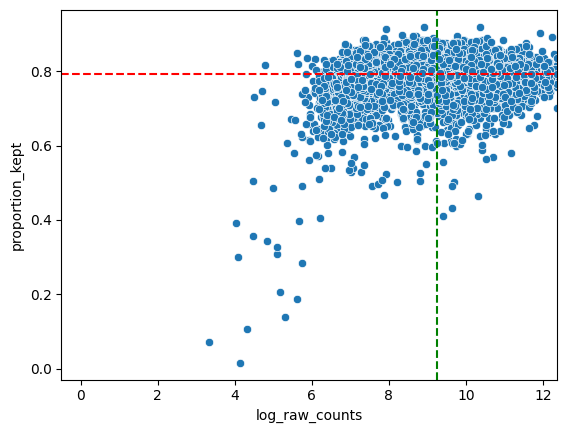

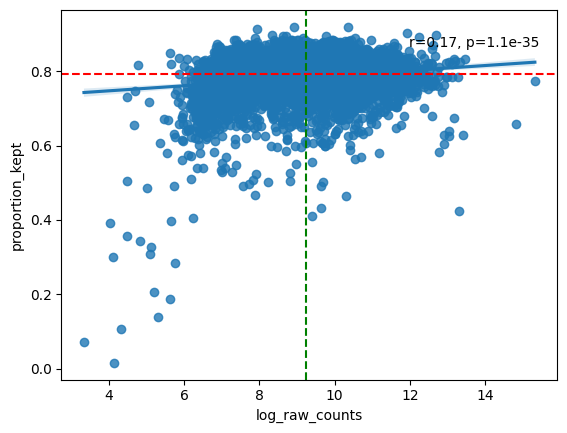

2025-11-26 19:59:56,874 - harpy.plot._transcripts - INFO - The ten genes with the highest proportion of transcripts filtered out in the region of interest ([x_min,x_max,y_min,y_max]=(0, 54089, 0, 37631)):
                         proportion_kept  raw_counts
Human_CTNNB1_S33C_ALT:G         0.016129          62
Human_PTEN_G129E_WT:A           0.071429          28
CYP2A6                          0.106667          75
HPV16-E7                        0.139303         201
USP9Y                           0.187050         278
EIF1AY                          0.206704         179
PCDH11Y                         0.283439         314
F2                              0.300000          60
HPV18-E6                        0.308642         162
TBL1Y                           0.327273         165


In [33]:
labels_layer = "cell_labels_global_ROI1"
table_layer = "table_global_ROI1"
points_layer = "transcripts_global_ROI1"

filtered = hp.pl.analyse_genes_left_out(
    sdata,
    labels_layer=labels_layer,
    table_layer=table_layer,
    points_layer=points_layer,
    to_coordinate_system=to_coordinate_system,
)

We proceed with filtering of cells with low transcript count, and genes with low cell count; normalization using cell size; a log transformation; and scaling such that the data has mean zero and a variance of one.

In [38]:
sdata = hp.tb.preprocess_transcriptomics(
    sdata,
    labels_layer=labels_layer,
    table_layer=table_layer,
    output_layer="table_global_ROI1_preprocessed",
    size_norm=True,
    update_shapes_layers=False,
    overwrite=True,
)

2025-11-26 20:02:20,817 - harpy.table._preprocess - INFO - Calculating cell size from provided labels_layer 'cell_labels_global_ROI1'
2025-11-26 20:03:03,741 - harpy.table._preprocess - INFO - Saving non preprocessed data matrix to '.layers[raw_counts]'.


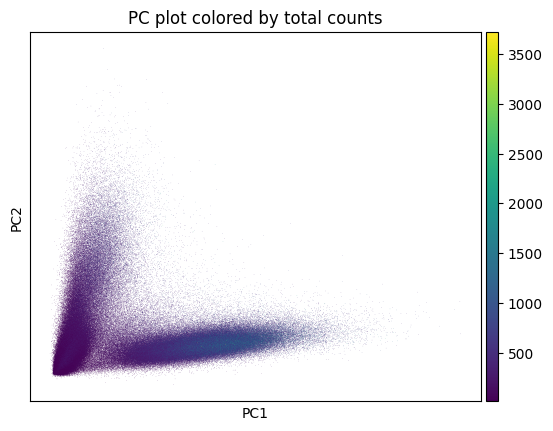

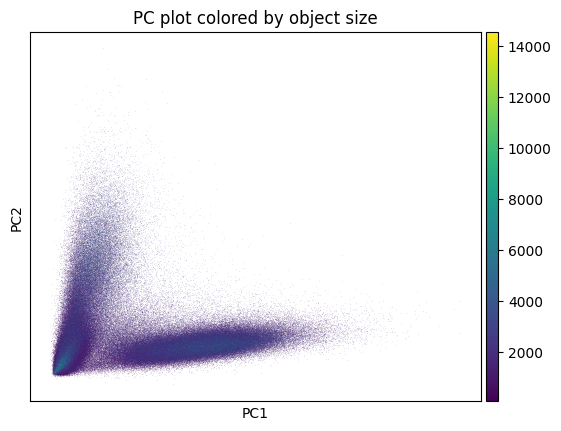

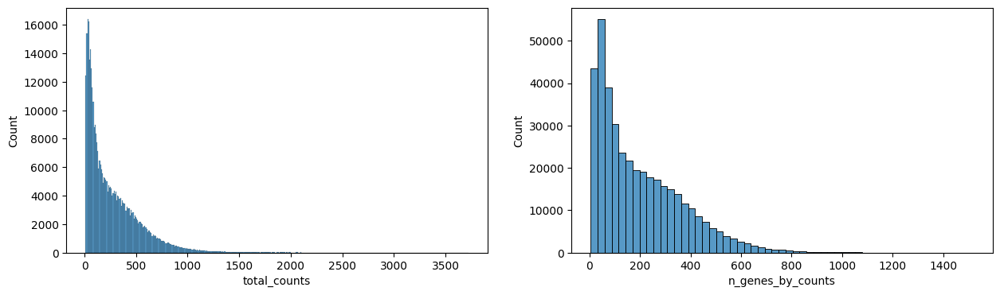

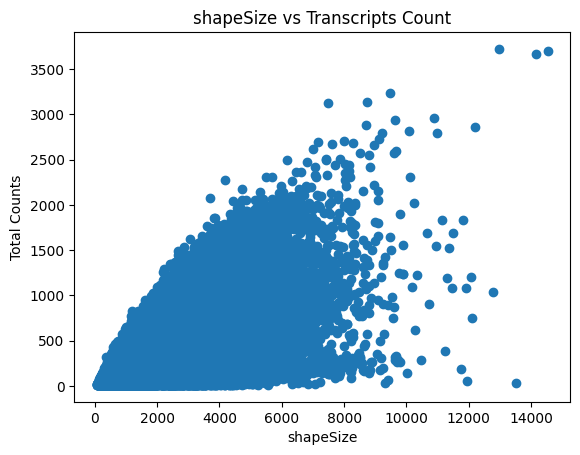

In [42]:
hp.pl.preprocess_transcriptomics(
    sdata,
    table_layer="table_global_ROI1_preprocessed",
)

Visualize the expression after preprocessing.

INFO     Rasterizing image for faster rendering.                                                                   
INFO     Rasterizing image for faster rendering.                                                                   


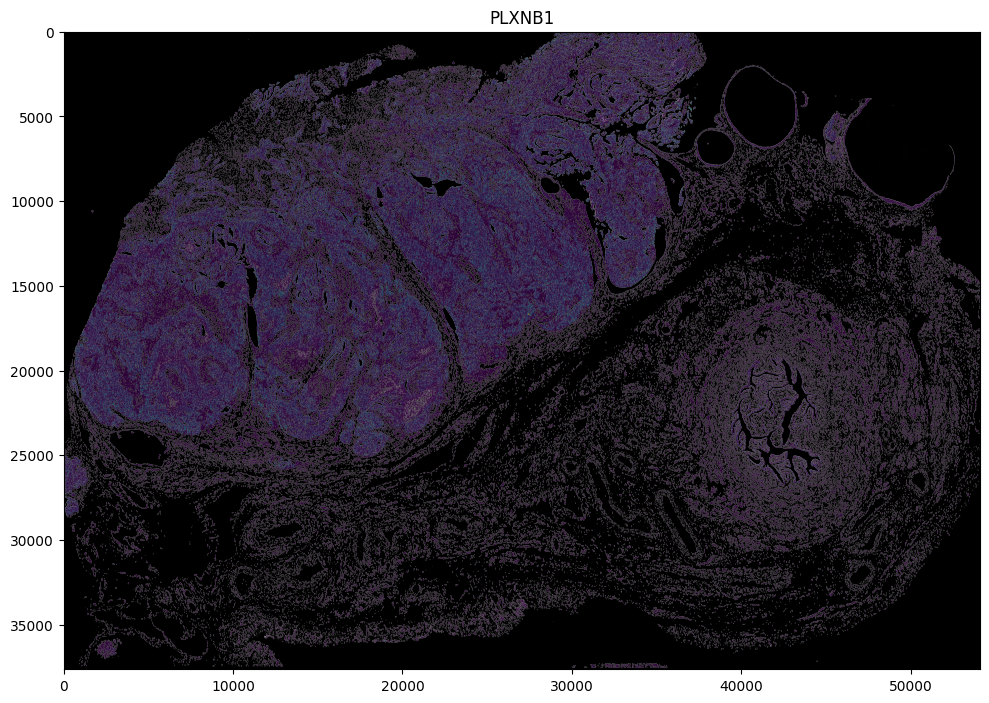

In [46]:
# show expression after preprocessing;
import matplotlib.pyplot as plt

channel = "DAPI"
img_layer = "morphology_focus_global_ROI1"
labels_layer = "cell_labels_global_ROI1"
table_layer = "table_global_ROI1_preprocessed"

fig, axes = plt.subplots(1, 1, figsize=(10, 10))

to_coordinate_system = to_coordinate_system
scale = None  # auto pick scale by spatialdata-plot
color = "PLXNB1"  # visualize expression of specific genes
crd = None

# if points in, query is slow, so remove them for plotting
sdata_to_plot = sdata.subset(element_names=[img_layer, labels_layer, table_layer])

render_images_kwargs = {"cmap": "grey", "norm": None, "scale": scale}
render_labels_kwargs = {"fill_alpha": 0.5, "outline_alpha": 0.4, "scale": scale}
show_kwargs = {
    "title": color,
    "colorbar": False,
}
axes = hp.pl.plot_sdata(
    sdata_to_plot,
    img_layer=img_layer,
    labels_layer=labels_layer,
    table_layer=table_layer,
    color=color,
    channel=channel,
    crd=crd,
    render_images_kwargs=render_images_kwargs,
    show_kwargs=show_kwargs,
    ax=axes,
    to_coordinate_system=to_coordinate_system,
)

plt.tight_layout()
plt.show()

## 6. Leiden clustering.

In [ ]:
# takes around 40 minutes
# This can consume quite some RAM, as the AnnData table is in memory.

labels_layer = "cell_labels_global_ROI1"
table_layer = "table_global_ROI1_preprocessed"

sdata = hp.tb.leiden(
    sdata,
    labels_layer=labels_layer,
    table_layer=table_layer,
    output_layer=table_layer,
    overwrite=True,
)

In [20]:
sdata.tables["table_global_ROI1_preprocessed"].obs.head()

,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,...,cell_ID,group,n_genes_by_counts,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_2_genes,pct_counts_in_top_5_genes,n_counts,shapeSize,leiden
cell_id,,,,,,,,,,,,,,,,,,,,,
aaaaebmm-1,303,0,0,0,0,31,303.0,44.659533,31.835157,1.0,...,1,Proliferative Tumor Cells,246,5.509388,5.717028,7.260726,10.231023,303.0,989,3
aaaafhpp-1,311,0,0,0,0,28,311.0,57.664533,38.247345,1.0,...,2,Tumor Cells,255,5.545177,5.743003,2.893891,6.109325,311.0,1277,10
aaaahcem-1,301,0,0,0,0,32,301.0,39.827814,27.590470,1.0,...,3,Proliferative Tumor Cells,249,5.521461,5.710427,4.983389,8.637874,301.0,882,3
aaaakeoi-1,369,0,0,0,0,58,369.0,60.870627,38.879533,1.0,...,4,Proliferative Tumor Cells,306,5.726848,5.913503,3.252033,5.962060,369.0,1348,3
aaaalald-1,295,0,0,0,0,47,295.0,50.484689,46.510939,1.0,...,5,Tumor Cells,254,5.541264,5.690360,5.423729,8.813559,295.0,1118,10


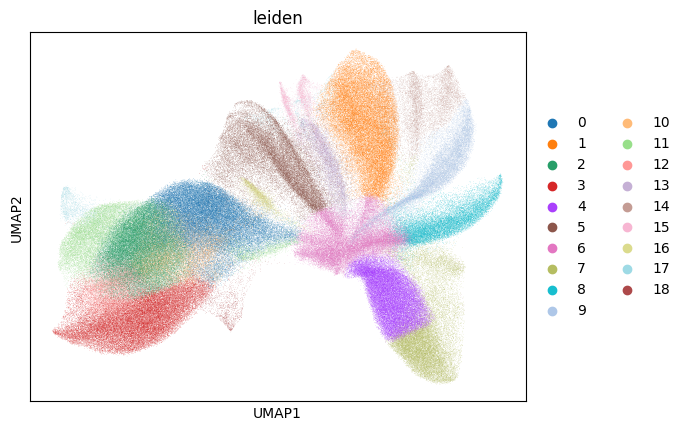

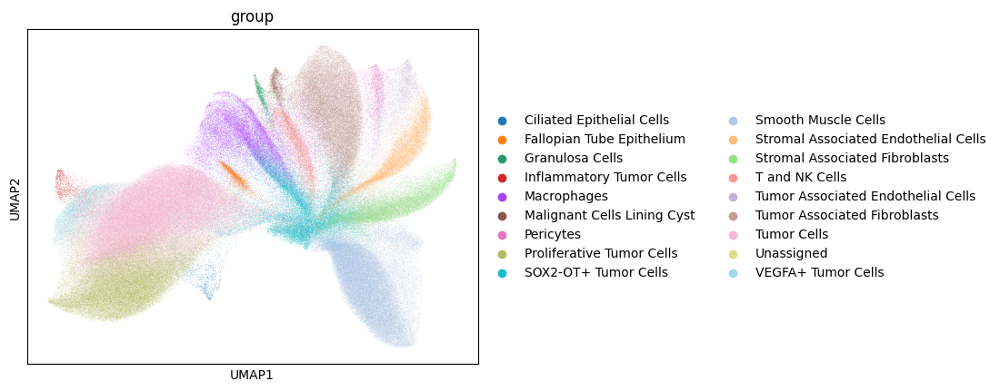

In [21]:
import scanpy as sc

sc.pl.umap(sdata.tables["table_global_ROI1_preprocessed"], color=["leiden"], show=True)
# this dataset is annotated, lets see how clusters correspond to cell type
sc.pl.umap(sdata.tables["table_global_ROI1_preprocessed"], color=["group"], show=True)

[<Axes: title={'center': '0 vs. rest'}, ylabel='score'>,
 <Axes: title={'center': '1 vs. rest'}>,
 <Axes: title={'center': '2 vs. rest'}>,
 <Axes: title={'center': '3 vs. rest'}>,
 <Axes: title={'center': '4 vs. rest'}, ylabel='score'>,
 <Axes: title={'center': '5 vs. rest'}>,
 <Axes: title={'center': '6 vs. rest'}>,
 <Axes: title={'center': '7 vs. rest'}>,
 <Axes: title={'center': '8 vs. rest'}, ylabel='score'>,
 <Axes: title={'center': '9 vs. rest'}>,
 <Axes: title={'center': '10 vs. rest'}>,
 <Axes: title={'center': '11 vs. rest'}>,
 <Axes: title={'center': '12 vs. rest'}, ylabel='score'>,
 <Axes: title={'center': '13 vs. rest'}>,
 <Axes: title={'center': '14 vs. rest'}>,
 <Axes: title={'center': '15 vs. rest'}>,
 <Axes: title={'center': '16 vs. rest'}, xlabel='ranking', ylabel='score'>,
 <Axes: title={'center': '17 vs. rest'}, xlabel='ranking'>,
 <Axes: title={'center': '18 vs. rest'}, xlabel='ranking'>]

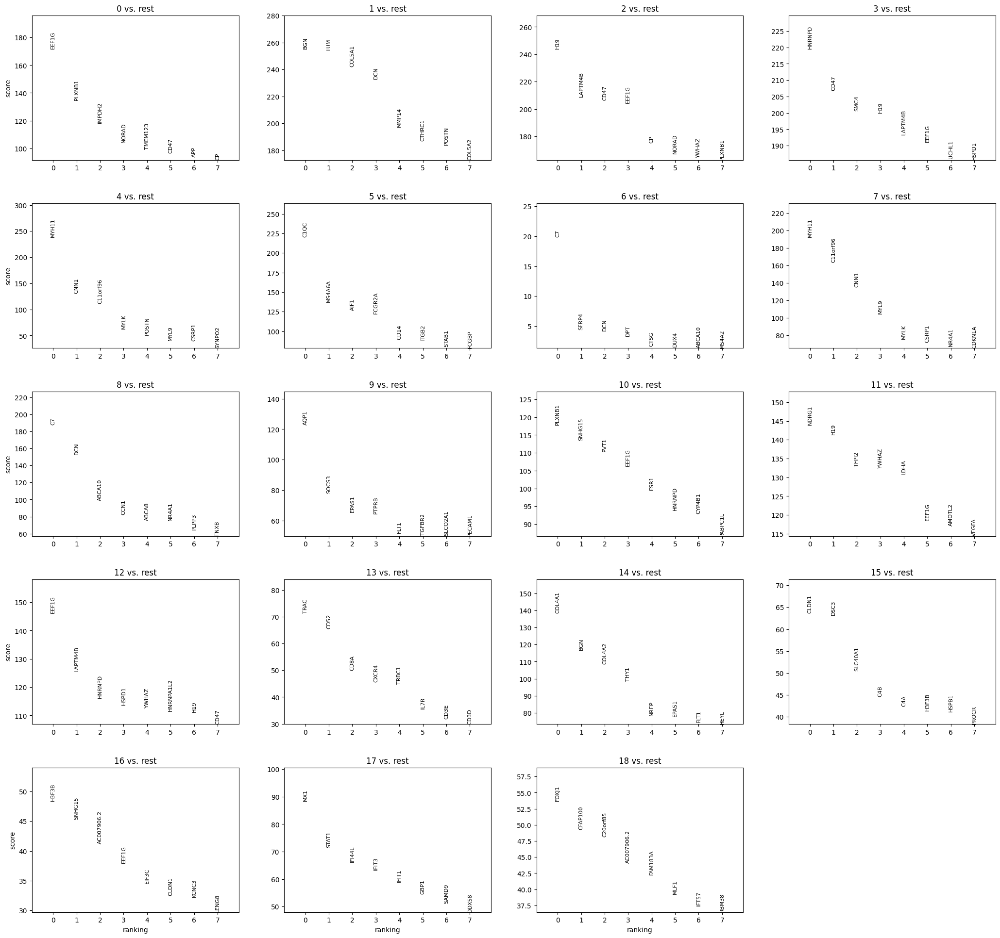

In [17]:
sc.pl.rank_genes_groups(sdata.tables["table_global_ROI1_preprocessed"], n_genes=8, sharey=False, show=False)

INFO     Rasterizing image for faster rendering.                                                                   
INFO     Rasterizing image for faster rendering.                                                                   


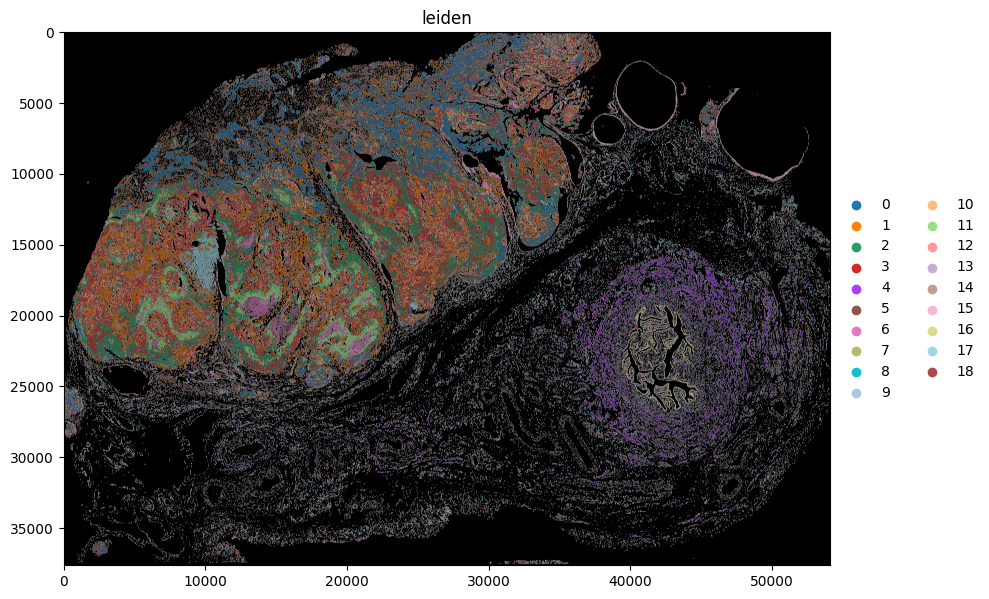

In [5]:
import matplotlib.pyplot as plt

channel = "DAPI"
img_layer = "morphology_focus_global_ROI1"
labels_layer = "cell_labels_global_ROI1"
table_layer = "table_global_ROI1_preprocessed"
to_coordinate_system = "global_ROI1"


to_coordinate_system = to_coordinate_system
scale = None  # auto pick scale by spatialdata-plot
crd = None

color = "leiden"

fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# if points in, query is slow, so remove them for plotting
sdata_to_plot = sdata.subset(element_names=[img_layer, labels_layer, table_layer])

render_images_kwargs = {"cmap": "grey", "norm": None, "scale": scale}
render_labels_kwargs = {"fill_alpha": 0.5, "outline_alpha": 0.4, "scale": scale}
show_kwargs = {
    "title": color,
    "colorbar": False,
}
ax = hp.pl.plot_sdata(
    sdata_to_plot,
    img_layer=img_layer,
    labels_layer=labels_layer,
    table_layer=table_layer,
    color=color,
    channel=channel,
    crd=crd,
    render_images_kwargs=render_images_kwargs,
    show_kwargs=show_kwargs,
    ax=ax,
    to_coordinate_system=to_coordinate_system,
)
# _ax.axis("off")

plt.tight_layout()
plt.show()

INFO     Rasterizing image for faster rendering.                                                                   
INFO     Rasterizing image for faster rendering.                                                                   


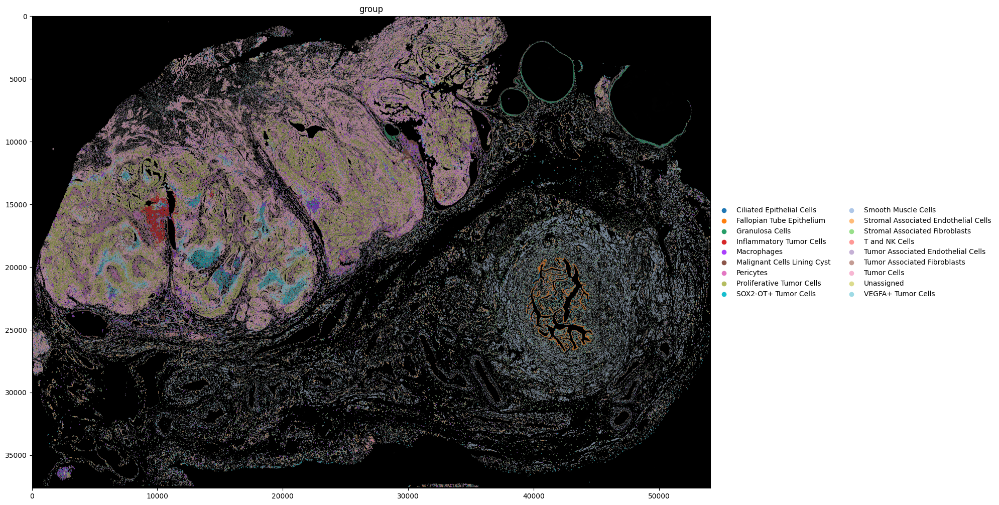

In [3]:
import matplotlib.pyplot as plt

channel = "DAPI"
img_layer = "morphology_focus_global_ROI1"
labels_layer = "cell_labels_global_ROI1"
table_layer = "table_global_ROI1_preprocessed"
to_coordinate_system = "global_ROI1"


to_coordinate_system = to_coordinate_system
scale = None  # auto pick scale by spatialdata-plot
crd = None

color = "group"

fig, ax = plt.subplots(1, 1, figsize=(20, 20))

# if points in, query is slow, so remove them for plotting
sdata_to_plot = sdata.subset(element_names=[img_layer, labels_layer, table_layer])

render_images_kwargs = {"cmap": "grey", "norm": None, "scale": scale}
render_labels_kwargs = {"fill_alpha": 0.5, "outline_alpha": 0.4, "scale": scale}
show_kwargs = {
    "title": color,
    "colorbar": False,
}
ax = hp.pl.plot_sdata(
    sdata_to_plot,
    img_layer=img_layer,
    labels_layer=labels_layer,
    table_layer=table_layer,
    color=color,
    channel=channel,
    crd=crd,
    render_images_kwargs=render_images_kwargs,
    show_kwargs=show_kwargs,
    ax=ax,
    to_coordinate_system=to_coordinate_system,
)
# _ax.axis("off")

plt.tight_layout()
plt.show()

Note the correspondence between Leiden cluster 17, and the Inflammatory Tumor Cells.

We also estimate the correlation between leiden clusters and the annotated cell type.

Cramers v: 0.7613470480652001
Chi-squared statistic: 3925208.4534459906
p-value: 0.0


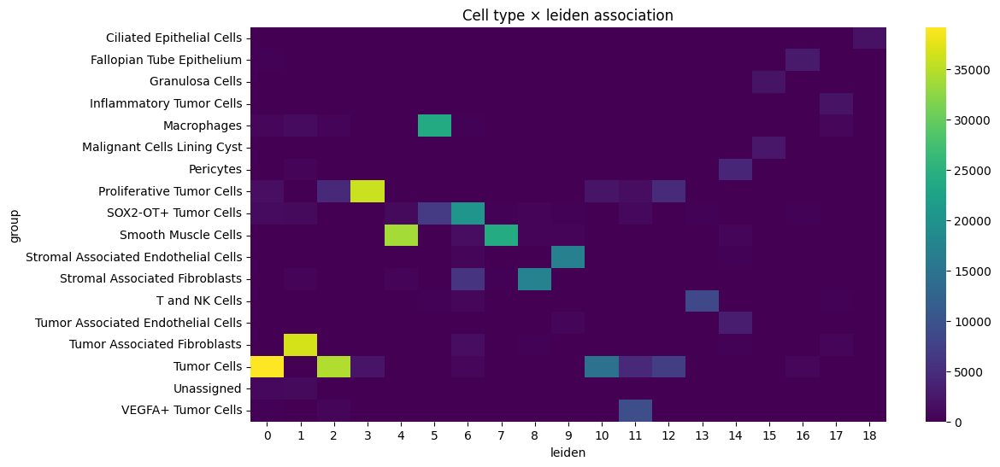

                                cell_type leiden  std_residual   abs_resid
199  Stromal Associated Endothelial Cells      9    558.842983  558.842983
241                        T and NK Cells     13    554.391652  554.391652
18              Ciliated Epithelial Cells     18    553.300254  553.300254
267          Tumor Associated Fibroblasts      1    513.570314  513.570314
35              Fallopian Tube Epithelium     16    505.783565  505.783565
217        Stromal Associated Fibroblasts      8    485.604699  485.604699
81                            Macrophages      5    466.487412  466.487412
136             Proliferative Tumor Cells      3    449.341736  449.341736
334                    VEGFA+ Tumor Cells     11    438.169924  438.169924
110           Malignant Cells Lining Cyst     15    425.370919  425.370919
74               Inflammatory Tumor Cells     17    425.115462  425.115462
128                             Pericytes     14    400.937651  400.937651
175                   Smo

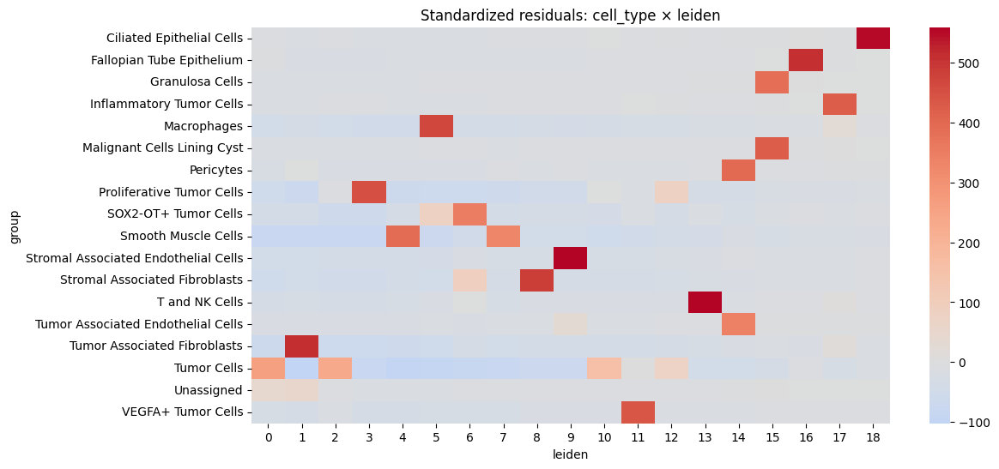

In [8]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import chi2_contingency

table_layer = "table_global_ROI1_preprocessed"
cluster_key = "leiden"
cell_type_key = "group"

df = sdata[table_layer].obs

df = df[~df[cell_type_key].isna()]

contingency = pd.crosstab(df[cell_type_key], df[cluster_key])

# chi squared test
chi2, p, dof, expected = chi2_contingency(contingency)


# cramers v
def _cramers_v(confusion_matrix):
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    return np.sqrt(phi2 / min(k - 1, r - 1))


print("Cramers v:", _cramers_v(contingency))

print("Chi-squared statistic:", chi2)
print("p-value:", p)

plt.figure(figsize=(12, 6))
sns.heatmap(contingency, cmap="viridis")
plt.title(f"Cell type × {cluster_key} association")
plt.show()

# Calculate standardized residuals
residuals = (contingency - expected) / np.sqrt(expected)

residuals_df = pd.DataFrame(residuals, index=contingency.index, columns=contingency.columns)

resid_long = residuals_df.stack().reset_index()
resid_long.columns = ["cell_type", cluster_key, "std_residual"]

# Sort by strength of deviation
resid_long["abs_resid"] = resid_long["std_residual"].abs()
top_effects = resid_long.sort_values("abs_resid", ascending=False).head(20)
print(top_effects)

plt.figure(figsize=(12, 6))
sns.heatmap(residuals_df, center=0, cmap="coolwarm", annot=False)
plt.title(f"Standardized residuals: cell_type × {cluster_key}")
plt.show()